# Проект

## Постановка задачи

Мы сотрудники добывающей компании «ГлавРосГосНефть». Нам нужно решить, где бурить новую скважину, посчитав прибыль для конкретной скважины и для всего региона, а также посчитать риски.

В нашем распределении есть пробы нефти в трёх регионах: в каждом 10 000 месторождений, где измерили качество нефти и объём её запасов. Данные для каждой скважины представлены в виде трех признаков. Мы не знаем, в чем их смысл, но знаем, что признаки значимые. Целевой признак представлен в виде объёма запасов в скважине (тыс. баррелей).

У нас есть информация касательно стоимости разработки скважин и прибыли от продажи нефти. 
* Бюджет на разработку скважин в регионе — 10 млрд рублей
* При нынешних ценах один баррель сырья приносит 450 рублей дохода. Доход с каждой единицы продукта составляет 450 тыс. рублей, поскольку объём указан в тысячах баррелей
* При разведке региона исследуют 500 точек, из которых с помощью машинного обучения выбирают 200 лучших для разработки
* После оценки рисков нужно оставить лишь те регионы, в которых вероятность убытков меньше 2.5%. Среди них выбирают регион с наибольшей средней прибылью


## Загрузка и подготовка данных

Посмотрим на данные

In [1]:
import pandas as pd
import os
import warnings
from sklearn.metrics import make_scorer, mean_squared_error
from sklearn.model_selection import train_test_split
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from itertools import combinations
from sklearn.model_selection import cross_validate, cross_val_score
from statsmodels.tools import add_constant
from statsmodels.stats.stattools import durbin_watson
from statsmodels.stats.diagnostic import het_white, het_breuschpagan
from statsmodels.regression.linear_model import OLS
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm
from scipy.stats import shapiro, chisquare
from statsmodels.stats.diagnostic import lilliefors
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

pd.options.mode.chained_assignment = None
warnings.simplefilter(action='ignore', category=FutureWarning)
is_need_learn = True

In [2]:
def open_file(filename, indexcol=None):
    path_home = './datasets/' + filename
    path_server = '/datasets/' + filename
    path_full = filename
    if os.path.exists(path_home):
        return pd.read_csv(path_home, index_col=indexcol)
    elif os.path.exists(path_server):
        return pd.read_csv(path_server, index_col=indexcol)
    elif os.path.exists(path_full):
        return pd.read_csv(path_full, index_col=indexcol)
    else:
        raise FileNotFoundError("cannot find file " + filename)

In [3]:
data_0 = open_file('geo_data_0.csv')
data_1 = open_file('geo_data_1.csv')
data_2 = open_file('geo_data_2.csv')

In [4]:
data_0.info()
display(data_0.head())
data_1.info()
display(data_1.head())
data_2.info()
data_2.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       100000 non-null  object 
 1   f0       100000 non-null  float64
 2   f1       100000 non-null  float64
 3   f2       100000 non-null  float64
 4   product  100000 non-null  float64
dtypes: float64(4), object(1)
memory usage: 3.8+ MB


,id,f0,f1,f2,product
0,txEyH,0.705745,-0.497823,1.221170,105.280062
1,2acmU,1.334711,-0.340164,4.365080,73.037750
2,409Wp,1.022732,0.151990,1.419926,85.265647
3,iJLyR,-0.032172,0.139033,2.978566,168.620776
4,Xdl7t,1.988431,0.155413,4.751769,154.036647


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       100000 non-null  object 
 1   f0       100000 non-null  float64
 2   f1       100000 non-null  float64
 3   f2       100000 non-null  float64
 4   product  100000 non-null  float64
dtypes: float64(4), object(1)
memory usage: 3.8+ MB


,id,f0,f1,f2,product
0,kBEdx,-15.001348,-8.276000,-0.005876,3.179103
1,62mP7,14.272088,-3.475083,0.999183,26.953261
2,vyE1P,6.263187,-5.948386,5.001160,134.766305
3,KcrkZ,-13.081196,-11.506057,4.999415,137.945408
4,AHL4O,12.702195,-8.147433,5.004363,134.766305


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       100000 non-null  object 
 1   f0       100000 non-null  float64
 2   f1       100000 non-null  float64
 3   f2       100000 non-null  float64
 4   product  100000 non-null  float64
dtypes: float64(4), object(1)
memory usage: 3.8+ MB


,id,f0,f1,f2,product
0,fwXo0,-1.146987,0.963328,-0.828965,27.758673
1,WJtFt,0.262778,0.269839,-2.530187,56.069697
2,ovLUW,0.194587,0.289035,-5.586433,62.871910
3,q6cA6,2.236060,-0.553760,0.930038,114.572842
4,WPMUX,-0.515993,1.716266,5.899011,149.600746


Все, как и было оговорено в условии - три таблицы (каждая для отдельного региона), в каждой таблице данные для 10000 скважин. Целевой признак __product__ представляет собой количество тысяч баррелей нефти в месторождении, а признаки __f1__, __f2__ и __f3__ - некоторые значимые числа с плавающей точкой. Пропусков нет.

In [5]:
print('Uniq id in table 0', len(data_0['id'].unique()))
print('Uniq id in table 1', len(data_1['id'].unique()))
print('Uniq id in table 2', len(data_2['id'].unique()))

Uniq id in table 0 99990
Uniq id in table 1 99996
Uniq id in table 2 99996


In [6]:
print('Uniq id in table 0', data_0.duplicated().sum())
print('Uniq id in table 1', data_1.duplicated().sum())
print('Uniq id in table 2', data_2.duplicated().sum())

Uniq id in table 0 0
Uniq id in table 1 0
Uniq id in table 2 0


В таблицах есть коллизии с id скважин, но так как данные признаков для них различаются - не будем обращать внимания на этот факт, главное - не делать столбец __id__ индексом таблицы.

В нашей задаче мы будем строить линейную регрессию. Преобразование категориальных признаков в численные нам не требуется, нормализация данных тоже бесполезна (алгоритм сам вычислит коэффициенты значимости для каждого признака). Единственное, что мы можем сделать - создать новые признаки в виде степеней исходных, а также логарифмировать целевой признак. Так как нам не придется возиться с гиперпараметрами, как это было бы в случае классификации, сделаем все вышеописанное.

Генерировать новые признаки будем с помощью класса PolynomialFeatures, степень - 2.

In [7]:
def make_poly_df(data):
    poly = PolynomialFeatures(2)
    poly_feat_0 = poly.fit_transform(data)
    return pd.DataFrame(poly_feat_0, columns = poly.get_feature_names(data.columns))

In [8]:
data_0_poly = make_poly_df(data_0[['f1', 'f2', 'f0']])
data_1_poly = make_poly_df(data_1[['f1', 'f2', 'f0']])
data_2_poly = make_poly_df(data_2[['f1', 'f2', 'f0']])

In [9]:
display(data_0_poly.head(10))
display(data_1_poly.head(10))
data_2_poly.head(10)

,1,f1,f2,f0,f1^2,f1 f2,f1 f0,f2^2,f2 f0,f0^2
0,1.0,-0.497823,1.221170,0.705745,0.247827,-0.607926,-0.351336,1.491256,0.861835,0.498076
1,1.0,-0.340164,4.365080,1.334711,0.115712,-1.484844,-0.454021,19.053926,5.826122,1.781454
2,1.0,0.151990,1.419926,1.022732,0.023101,0.215815,0.155446,2.016191,1.452204,1.045981
3,1.0,0.139033,2.978566,-0.032172,0.019330,0.414118,-0.004473,8.871855,-0.095825,0.001035
4,1.0,0.155413,4.751769,1.988431,0.024153,0.738485,0.309027,22.579310,9.448565,3.953858
5,1.0,0.489775,-0.735383,0.969570,0.239879,-0.360172,0.474871,0.540788,-0.713006,0.940067
6,1.0,0.530656,1.780266,0.645075,0.281595,0.944708,0.342313,3.169347,1.148406,0.416122
7,1.0,0.808337,-5.624670,-0.400648,0.653408,-4.546627,-0.323859,31.636908,2.253514,0.160519
8,1.0,-0.551583,2.372141,0.643105,0.304244,-1.308433,-0.354726,5.627052,1.525536,0.413584
9,1.0,0.563698,9.441852,2.173381,0.317756,5.322357,1.225132,89.148573,20.520745,4.723586


,1,f1,f2,f0,f1^2,f1 f2,f1 f0,f2^2,f2 f0,f0^2
0,1.0,-8.276000,-0.005876,-15.001348,68.492175,0.048630,124.151157,0.000035,0.088148,225.040447
1,1.0,-3.475083,0.999183,14.272088,12.076203,-3.472243,-49.596693,0.998366,14.260424,203.692490
2,1.0,-5.948386,5.001160,6.263187,35.383293,-29.748830,-37.255855,25.011603,31.323203,39.227516
3,1.0,-11.506057,4.999415,-13.081196,132.389345,-57.523552,150.512988,24.994149,-65.398328,171.117696
4,1.0,-8.147433,5.004363,12.702195,66.380671,-40.772710,-103.490287,25.043645,63.566388,161.345755
5,1.0,-2.205276,3.003647,-3.327590,4.863241,-6.623871,7.338254,9.021897,-9.994907,11.072856
6,1.0,-10.133399,4.002382,-11.142655,102.685769,-40.557732,112.912966,16.019061,-44.597161,124.158761
7,1.0,-0.001354,2.004588,4.234715,0.000002,-0.002714,-0.005734,4.018373,8.488860,17.932813
8,1.0,-0.332068,4.998647,13.355129,0.110269,-1.659892,-4.434814,24.986472,66.757576,178.359472
9,1.0,-11.025667,4.997844,1.069227,121.565337,-55.104560,-11.788946,24.978440,5.343831,1.143247


,1,f1,f2,f0,f1^2,f1 f2,f1 f0,f2^2,f2 f0,f0^2
0,1.0,0.963328,-0.828965,-1.146987,0.928001,-0.798565,-1.104925,0.687183,0.950812,1.315579
1,1.0,0.269839,-2.530187,0.262778,0.072813,-0.682743,0.070908,6.401844,-0.664877,0.069052
2,1.0,0.289035,-5.586433,0.194587,0.083541,-1.614675,0.056243,31.208231,-1.087049,0.037864
3,1.0,-0.553760,0.930038,2.236060,0.306650,-0.515018,-1.238240,0.864970,2.079620,4.999963
4,1.0,1.716266,5.899011,-0.515993,2.945567,10.124270,-0.885581,34.798336,-3.043848,0.266249
5,1.0,0.710691,2.585887,-0.758092,0.505082,1.837767,-0.538769,6.686810,-1.960340,0.574703
6,1.0,0.317727,1.773745,-0.574891,0.100950,0.563566,-0.182658,3.146170,-1.019710,0.330500
7,1.0,-2.458350,-0.177097,-1.906649,6.043486,0.435367,4.687211,0.031363,0.337662,3.635311
8,1.0,-0.279356,3.004156,1.776292,0.078040,-0.839229,-0.496218,9.024956,5.336258,3.155212
9,1.0,-0.439314,5.922514,-1.214452,0.192997,-2.601845,0.533526,35.076172,-7.192612,1.474895


Посмотрим на распределение значений таргета и оценим необходимость его логарифмирования.

In [10]:
def pandas_bar_plot(bins, col, cur_data, title='', text=''):
    category_col = col + '_category'
    cur_data[category_col] = pd.cut(cur_data[col].to_list(), bins)
    plot_data = cur_data[category_col].value_counts().sort_index().rename_axis(category_col).reset_index(name='counts')
    
    plt = plot_data.plot(x=category_col, y='counts', kind='bar', title=title, grid=True, figsize=(15,8))
    plt.set_xlabel(text)
    plt.set_ylabel('Количество')

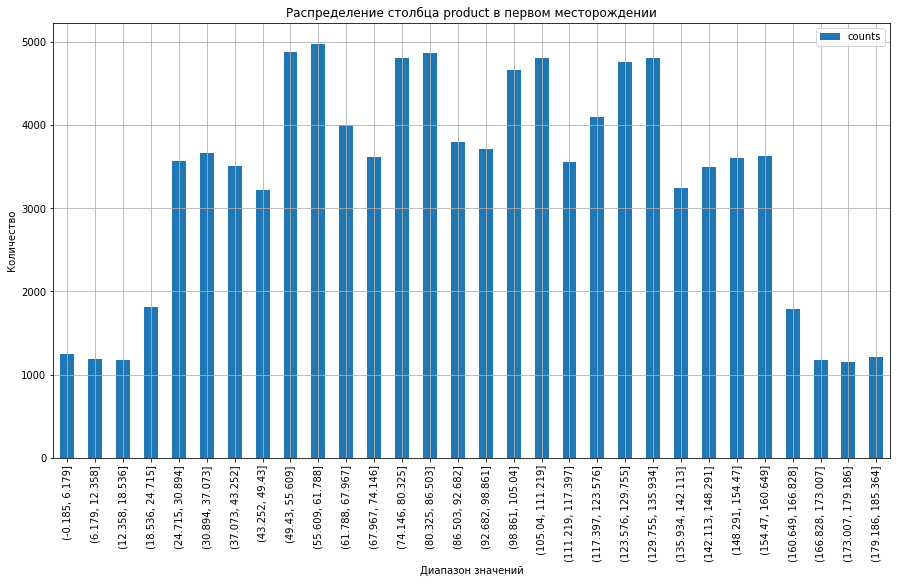

In [11]:
pandas_bar_plot(30, 'product', data_0, 'Распределение столбца product в первом месторождении', 'Диапазон значений')

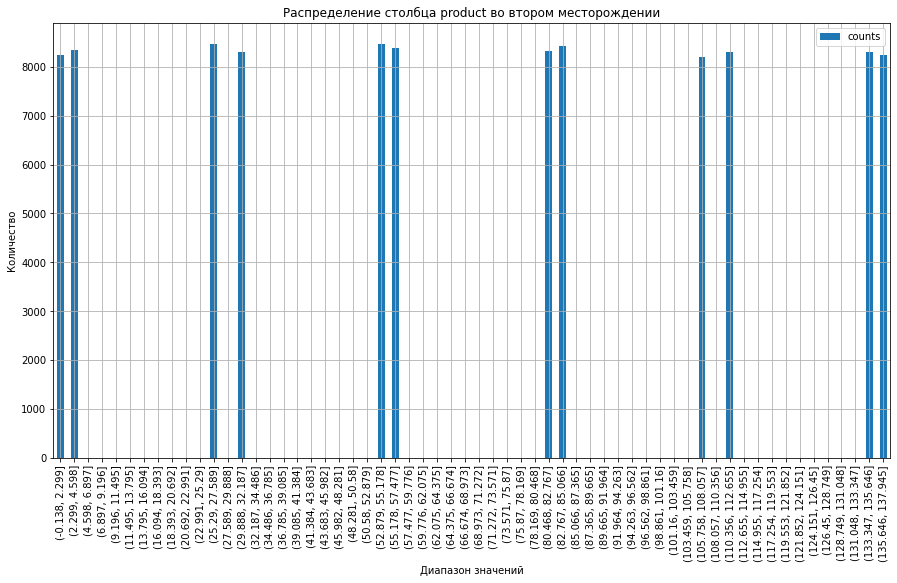

In [12]:
pandas_bar_plot(60, 'product', data_1, 'Распределение столбца product во втором месторождении', 'Диапазон значений')

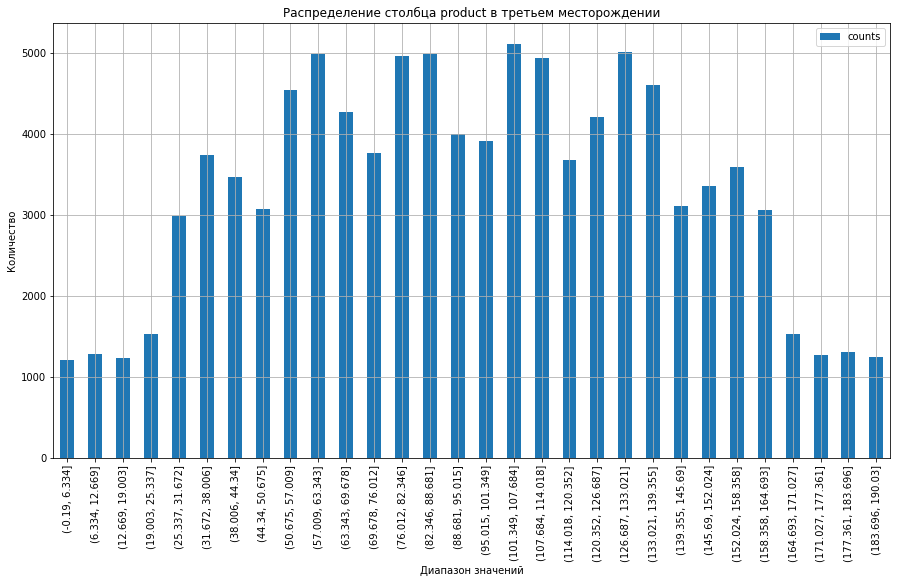

In [13]:
pandas_bar_plot(30, 'product', data_2, 'Распределение столбца product в третьем месторождении', 'Диапазон значений')

В первом и третьем регионе данные о количестве нефти распределены нормально, длинных хвостов - логарифмировать их нет необходимости. 

Данные во втором месторождении выглядят как дискретные и неподходящие для линейной регрессии вовсе.

Теперь убедимся, что данные во всех трех таблицах подходят для линейной регрессии. Для этого нам необходимо убедимо убедиться в выполнимости следующих условий:

* Линейная зависимость 

При линейной регрессии с 1 или 2 зависимыми переменными можно построить график, но в нашем случае переменных сильно больше. Поэтому лучше всего линейность будет визуализировать график остатков.

* Нормальное распределение остатков 

Тут все просто - проверяется любым тестом на нормальность (хи-квадрат, Шапиро-Уилка и т.д.)

* Гомоскедастичность 

Это свойство однородности остатков. Проверяется, например, тестами Уайта и Бройш-Пагана.

* Отсутствие мультиколлинеарности 

Для проверки коллинеарности можно применить Variance Inflation Factor

Так как большинство из условий - это условия на остатки, мы будем проверять пригодность модель при ее построении. Но для начала попытаемся избавиться от трети работы и формально проверим критерий линейной зависимости для второго региона. Как мы заметили выше, множество значений целевого признака в нем похоже на дискретное. Проверим это.

In [14]:
data_1['product'].value_counts()

53.906522     8472
26.953261     8468
84.038886     8431
57.085625     8390
3.179103      8337
80.859783     8320
30.132364     8306
134.766305    8304
110.992147    8303
0.000000      8235
137.945408    8233
107.813044    8201
Name: product, dtype: int64

Все так, оно и правда дискретно. Если мы посмотрим на распределение признаков для каждого отдельного значения целевого признака и заметим, что оно имеет широкий диапазон, то это будет означать отсутствие линейности в данных.

/home/bloodless/.local/lib/python3.8/site-packages/pandas/plotting/_matplotlib/core.py:337: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


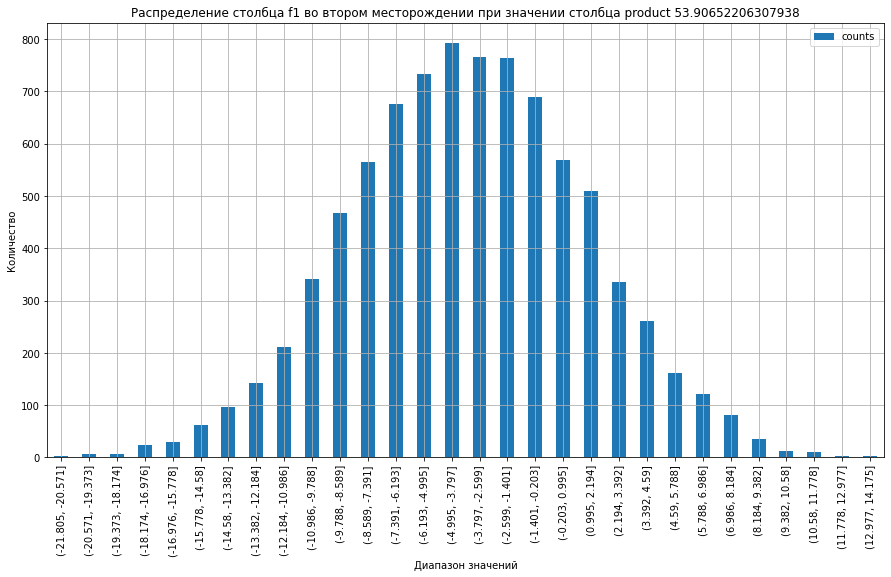

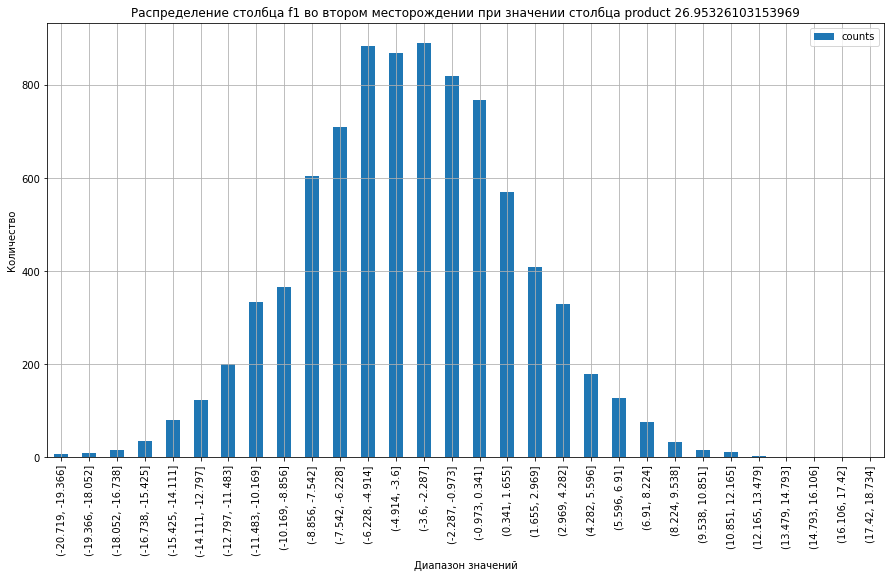

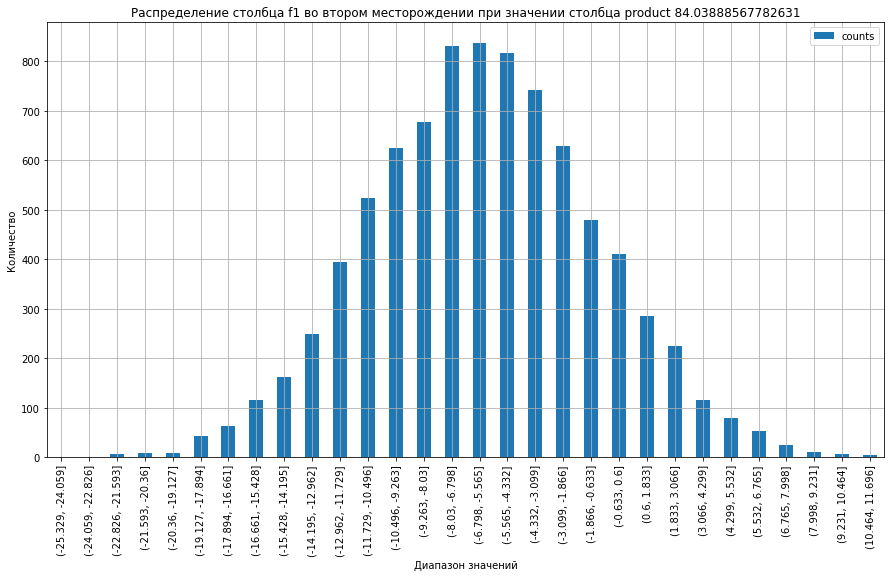

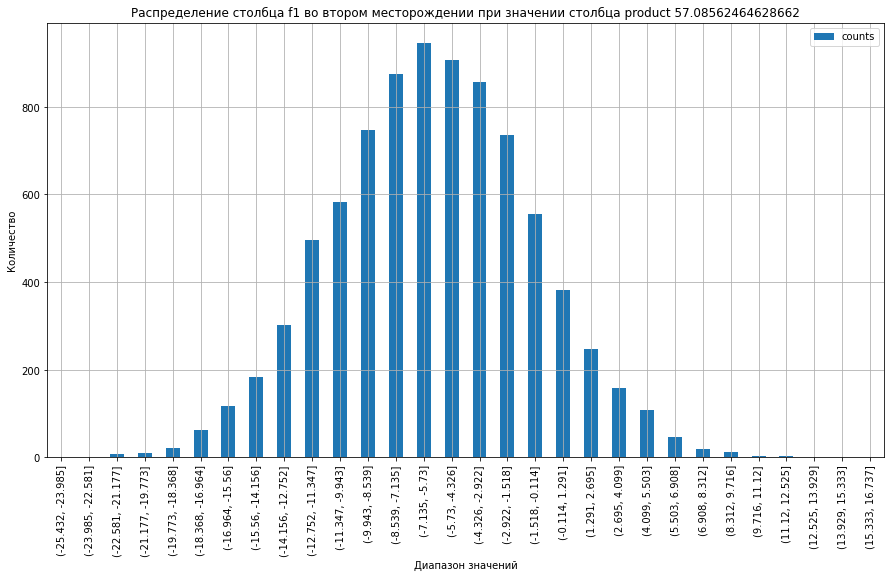

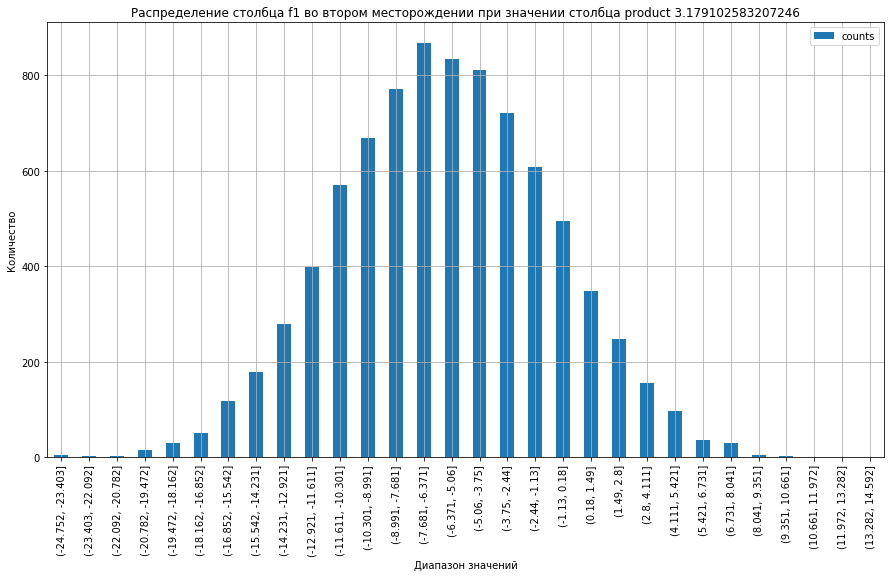

...

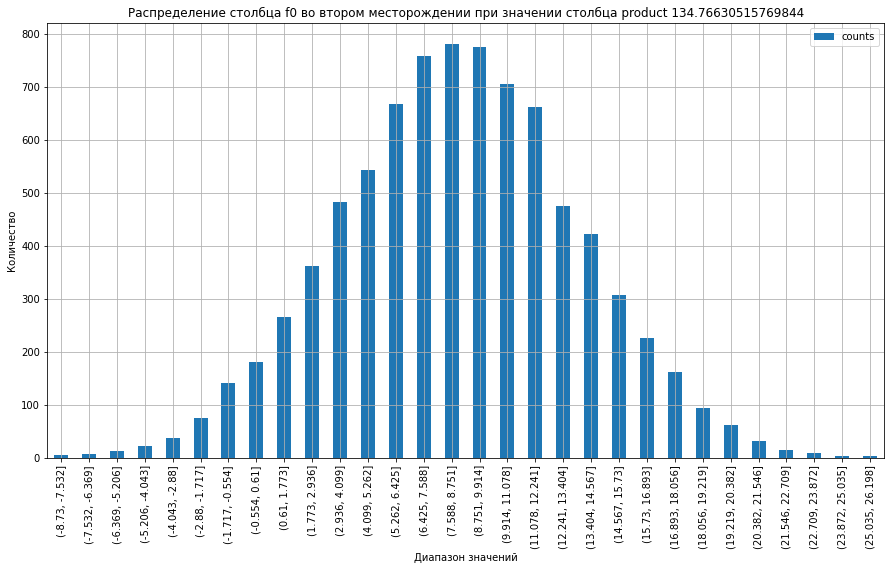

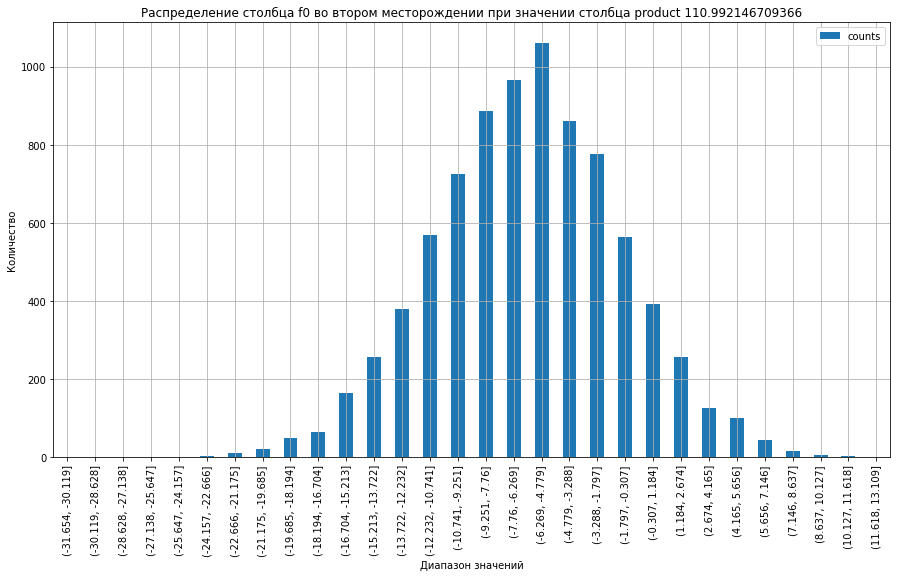

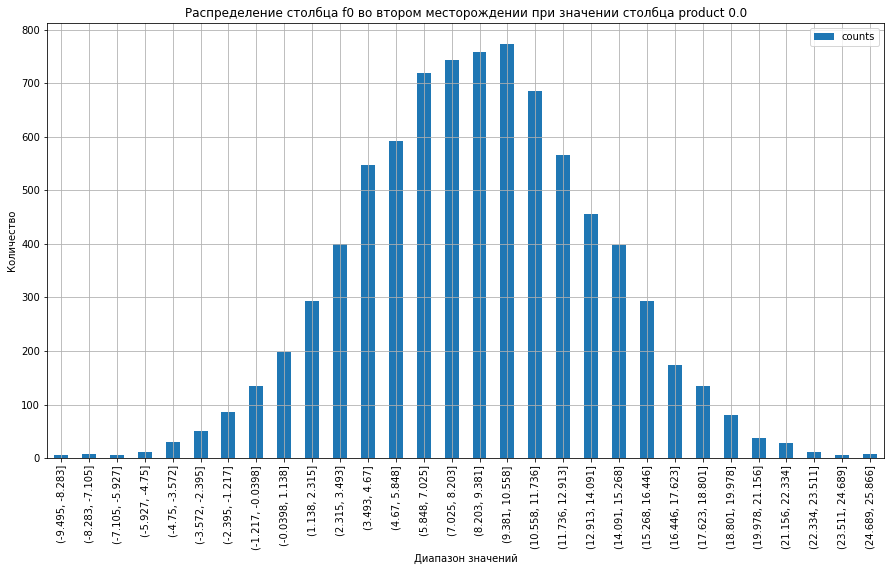

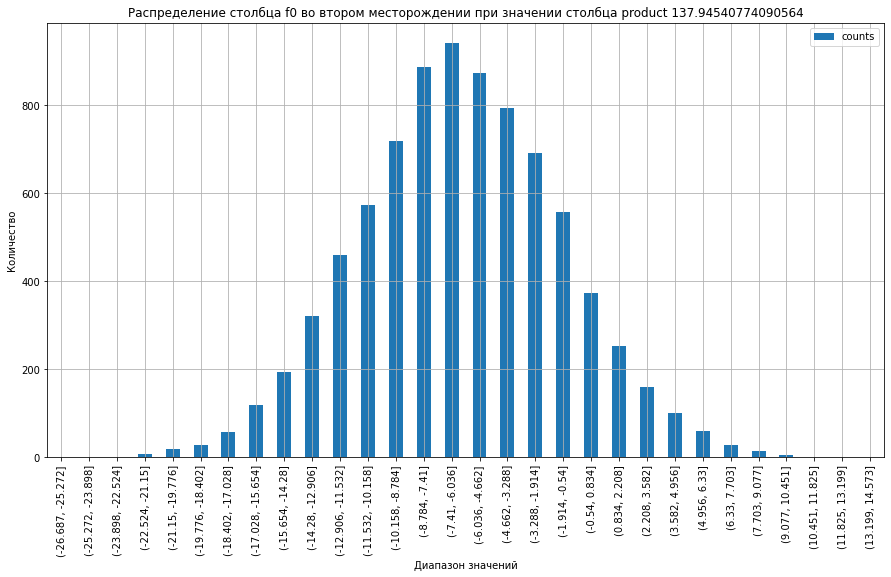

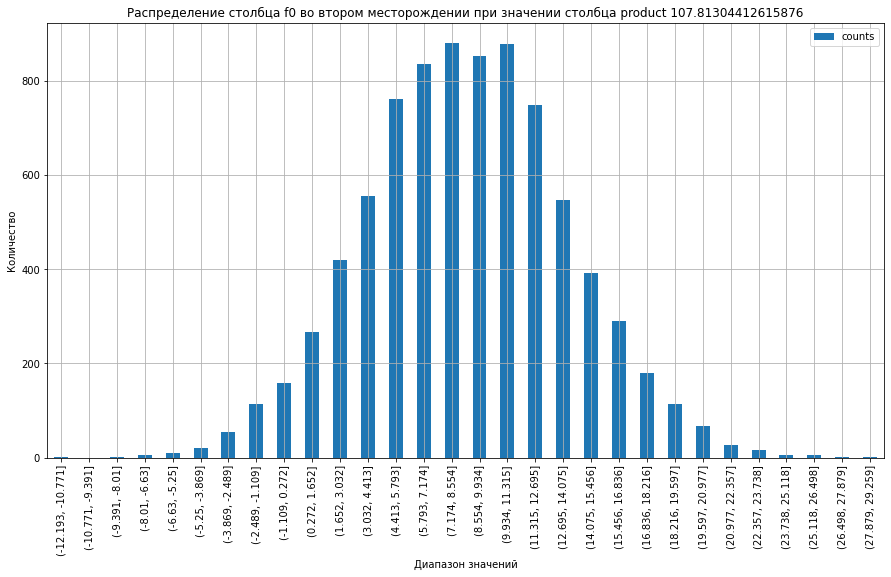

In [15]:
for param in ['f1', 'f2', 'f0']:
    for prod_val in data_1['product'].value_counts().index:
        pandas_bar_plot(30, param, data_1[data_1['product'] == float(prod_val)], 'Распределение столбца ' + param + ' во втором месторождении при значении столбца product ' + str(prod_val), 'Диапазон значений')

Также для наглядности построим boxplot для значения каждого параметра при различных значениях столбца __product__

In [16]:
def boxplot_by_param(col1, showfliers=True):
    list_prod = []
    list_col = []
    for prod_val in data_1['product'].value_counts().index:
        list_col += data_1[data_1['product'] == float(prod_val)][col1].tolist()
        list_prod += [float(prod_val)]*len(data_1[data_1['product'] == float(prod_val)][col1])
    
    plt.figure(figsize = (25,9))
    sns.set_style('darkgrid')

    fig = sns.boxplot( x=list_prod, y=list_col, palette = "cubehelix", showfliers = showfliers)

    plt.ylabel('Значение столбца ' + col1, fontsize = 17)
    plt.xlabel('Значение столбца product', fontsize = 17)
    plt.xticks(rotation = 90, fontsize = 13)
    plt.yticks(fontsize = 13)
    plt.title('Средние значения столбца ' + col1 + ' по различным значениям объема нефти в регионе 2', fontsize = 25)
    plt.grid(True, alpha = 0.5, linestyle = '-.', color = '#000000')
    plt.show()

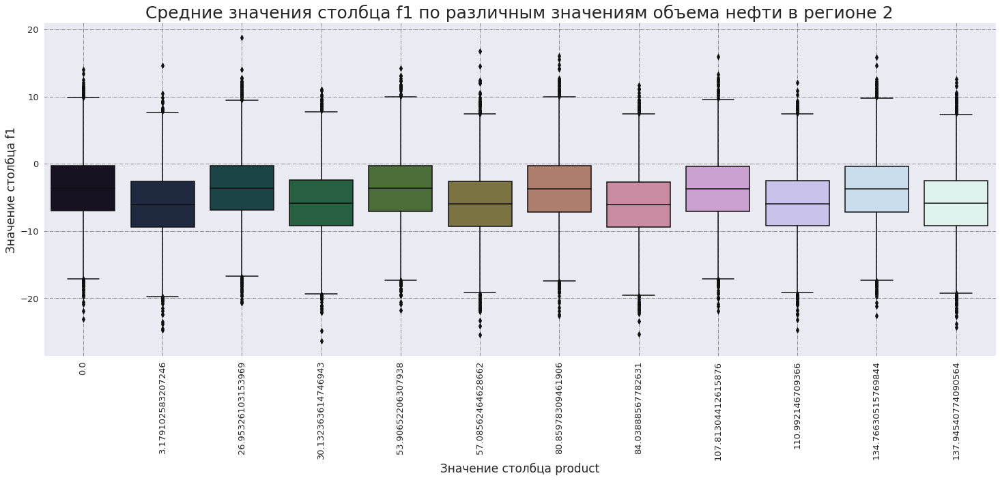

In [17]:
boxplot_by_param('f1')

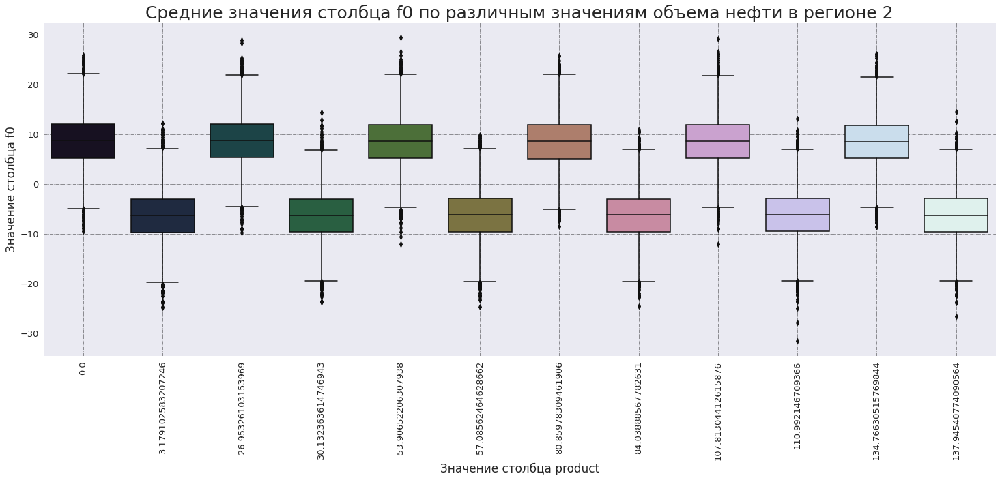

In [18]:
boxplot_by_param('f0')

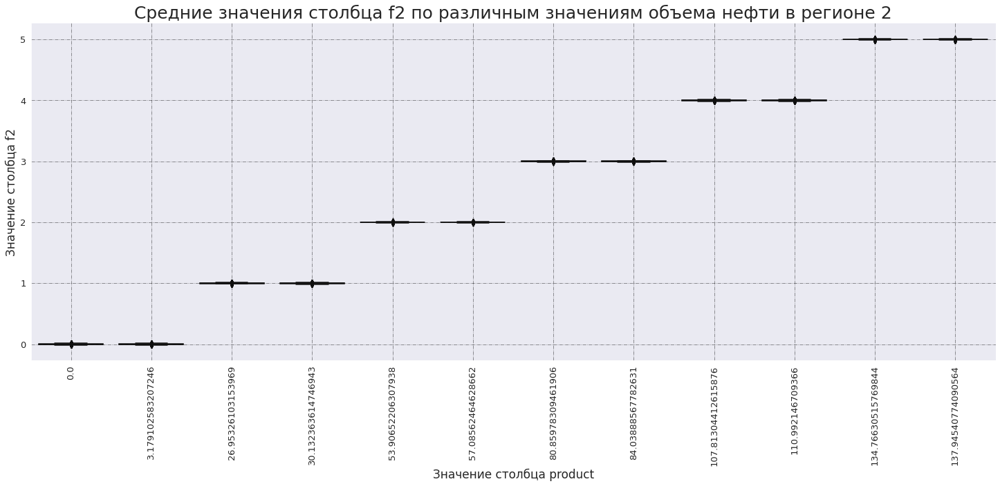

In [19]:
boxplot_by_param('f2')

По графикам видно, что признак __f1__ незначимый, а по __f0__ и __f2__ можно спрогнозировать значение столбца __product__, однако тут явно больше подходит задача классификации. Построим также трехмерный график зависимости таргета от двух значимых признаков.

In [20]:
fig = px.scatter_3d(data_1, x='f0', y='f2', z='product',
                    opacity=0.7, title='График зависимости столбца product от столбцов f0 и f2 во втором регионе')
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

Мне не хватает знаний, чтоб формально отвергнуть адекватность построения в этой ситуации линейной регрессии, поэтому модель мы построим. Надеюсь, где-то какой-то тест ругнется:)

Также определим множество всех комбинаций признаков.

In [21]:
features_list = []

for i in range(1, 11):
    comb = list(combinations(data_0_poly.columns, i))
    for a in comb:
        features_list.append(list(a))
    
len(features_list)

1023

Подготовим данные для обучения и валидации.

In [22]:
train_features_0, valid_features_0, train_target_0, valid_target_0 = train_test_split(data_0_poly, data_0['product'], random_state=12345, test_size=0.25)
train_features_1, valid_features_1, train_target_1, valid_target_1 = train_test_split(data_1_poly, data_1['product'], random_state=12345, test_size=0.25)
train_features_2, valid_features_2, train_target_2, valid_target_2 = train_test_split(data_2_poly, data_2['product'], random_state=12345, test_size=0.25)

 ## Обучение и проверка модели

В этом пункте мы определим признаки, на которых получается наилучшая модель. В качестве меры качества будем использовать Adjusted R^2 (в отличие от R^2 по нему можно корректно сравнивать модели со множественной регрессией).

Также в процессе поиска будем проверять остатки модели на гомоскедастичность и мультиколлинеарность. Гомоскедастичность будем проверять критерием Бройш-Пагана, а мультиколлинеарность - с помощью VIF (Variance Inflation Factor). Модели, у которых больше Adjusted R^2, но которые не проходят тесты (маленькое значение p-value теста Бройш-Пагана или большое значение VIF для какого-либо признака), сохранены не будут.

Остальные условия (нормальность остатков и линейность зависимости) мы проверим уже для выбранной наилучшей модели, построив графики остатков. Все дело в том, что линейность зависимости иначе, чем глазами на графике, наблюдать в принципе неизвестно как, а нормальность распределения выборки из 10000 остатков проверить каким-либо тестом очень тяжело - для данных, которые визуально выглядят нормальными, можно получить p-value теста крайне близкое к нулю. На самом деле к моменту написания отчета я проверил различные тесты на остатках, и даже тесты, рассчитанные на большие выборки (например, критерий Колмогорова-Смирнова с поправкой Лиллиефорса) давали значения 0.003 для визуально идеально нормальных данных. Таким подходом мы не построим ни одной модели на наших данных.

Обучаться и искать лучшую модель мы будем на обучающей выборке, определенной пунктом выше. В рамках этой выборки мы будем искать наилучшую модель с помощью кросс-валидации.

In [23]:
def model_best_fetures_and_score(train_features, train_target):
    data_0_max_score = -1
    data_0_max_feat = []

    if is_need_learn == True:
        for feat in features_list:
            classifier = LinearRegression()
            scores = cross_val_score(classifier, train_features[feat], train_target, cv=5,
                            scoring='r2')

            mean_r2 = sum(scores)/len(scores)
            n = train_target.count()
            mean_score = 1 - (1 - mean_r2)*(n - 1)/(n - len(feat) - 1) # adjusted R^2

            if (mean_score > data_0_max_score or data_0_max_score == -1):
                data_0_poly_const = add_constant(train_features[feat])
                model = OLS(train_target, data_0_poly_const).fit()
                hex_breuschpagan_stat = het_breuschpagan(model.resid, model.model.exog)
                vif = 0
                if len(feat) > 1:
                    vif = max([variance_inflation_factor(train_features[feat].values, j) for j in range(train_features[feat].shape[1])])

                if (hex_breuschpagan_stat[1] > 0.01 and vif < 10):
                    data_0_max_score = mean_score
                    data_0_max_feat = feat

    return data_0_max_score, data_0_max_feat

In [24]:
data_0_max_score, data_0_max_feat = model_best_fetures_and_score(train_features_0, train_target_0)
print('Максимальное значение метрики:', data_0_max_score)
print('Признаки:', data_0_max_feat)

Максимальное значение метрики: 0.2740574956226576
Признаки: ['f1', 'f2', 'f0']


In [25]:
data_1_max_score, data_1_max_feat = model_best_fetures_and_score(train_features_1, train_target_1)
print('Максимальное значение метрики:', data_1_max_score)
print('Признаки:', data_1_max_feat)

Максимальное значение метрики: 0.9996246695486244
Признаки: ['f1', 'f2', 'f0', 'f2 f0']


In [26]:
data_2_max_score, data_2_max_feat = model_best_fetures_and_score(train_features_2, train_target_2)
print('Максимальное значение метрики:', data_2_max_score)
print('Признаки:', data_2_max_feat)

Максимальное значение метрики: 0.22168165887815083
Признаки: ['f2', 'f2 f0', 'f0^2']


Теперь для каждой модели (кроме модели для второго региона - мы уже все там посмотрели) построим графики остатков и оценим нормальность.

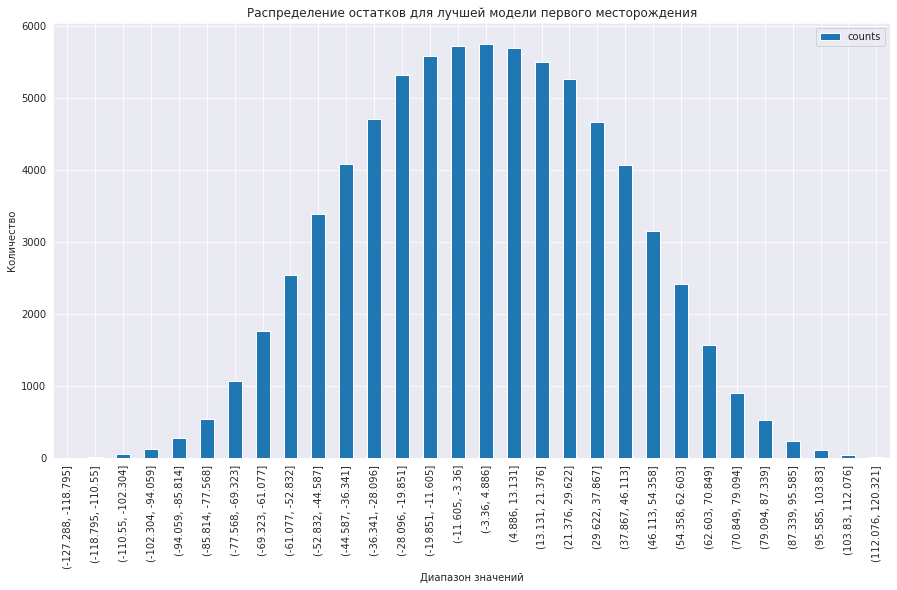

In [27]:
train_features_0['residuals'] = LinearRegression().fit(train_features_0[data_0_max_feat], train_target_0).predict(train_features_0[data_0_max_feat]) - train_target_0.tolist()
pandas_bar_plot(30, 'residuals', train_features_0, 'Распределение остатков для лучшей модели первого месторождения', 'Диапазон значений')

In [28]:
def resid_scatter(data, col_feat, col_resid):
    plt = data.plot(x=col_feat, y=col_resid, kind='scatter', title='Распределение остатков по значению столбца ' + col_feat, grid=True, figsize=(15,8), alpha=0.01)
    plt.set_xlabel('значение столбца ' + col_feat)
    plt.set_ylabel('Остатки')

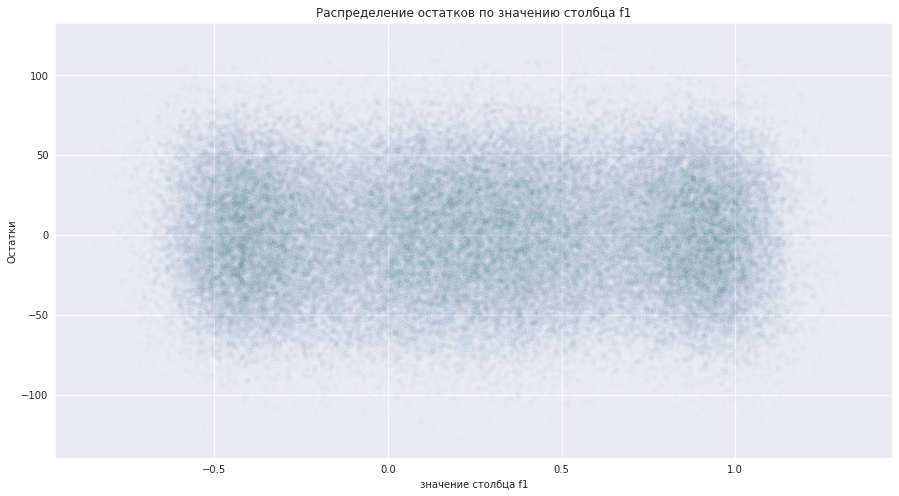

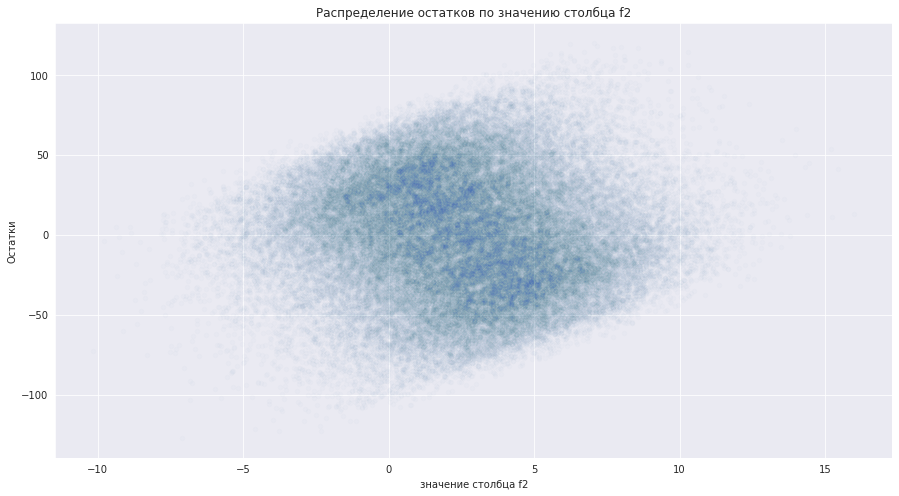

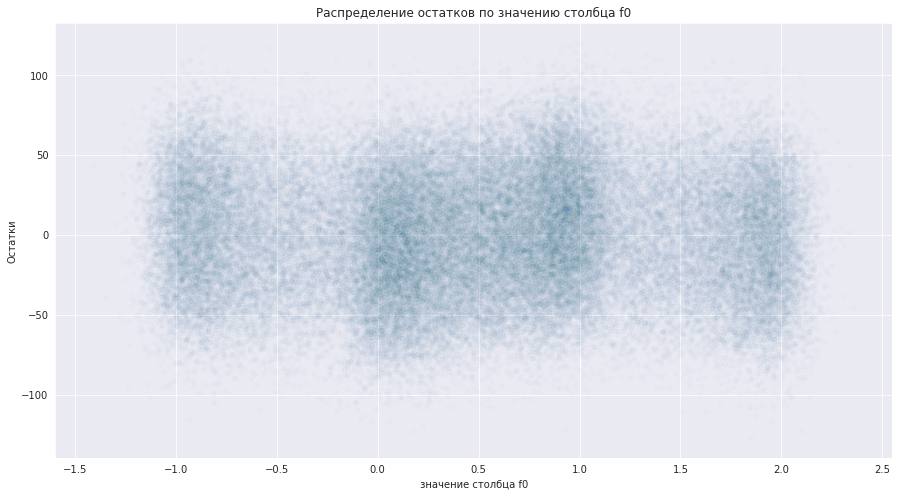

In [29]:
for feat in data_0_max_feat:
    resid_scatter(train_features_0, feat, 'residuals')

Остатки имеют нормальное распределение, а вот линейность данных, судя по графику для f2, немножко не очень. Но, буду честным, мне сложно оценить насколько не очень.

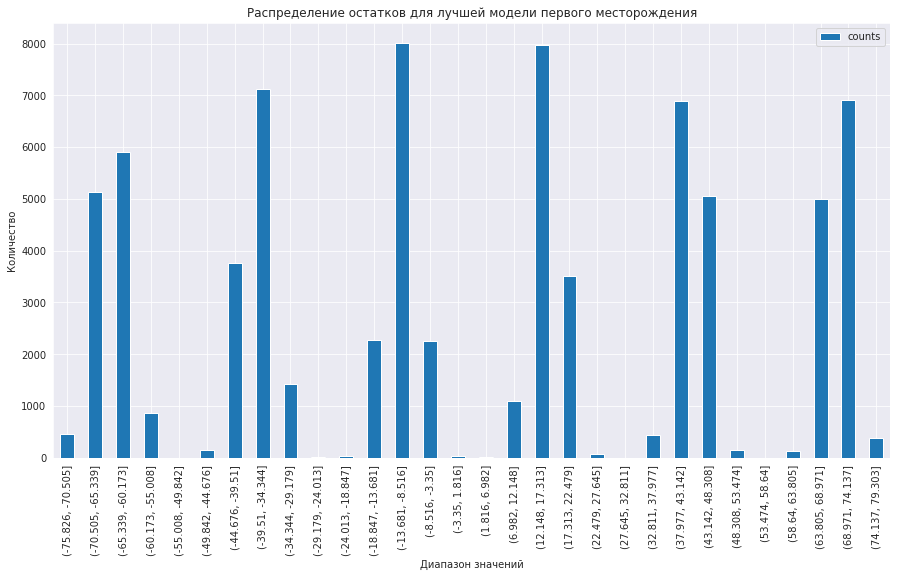

In [30]:
train_features_1['residuals'] = LinearRegression().fit(train_features_0[data_1_max_feat], train_target_1).predict(train_features_1[data_1_max_feat]) - train_target_1.tolist()
pandas_bar_plot(30, 'residuals', train_features_1, 'Распределение остатков для лучшей модели первого месторождения', 'Диапазон значений')

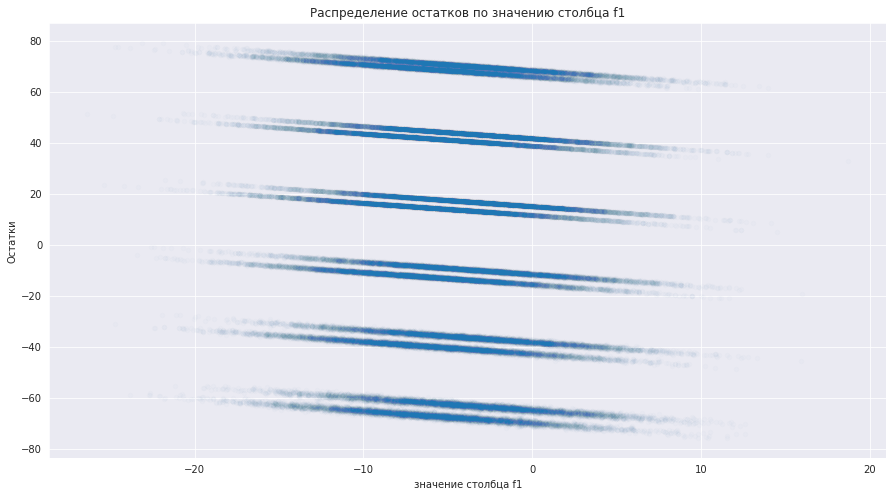

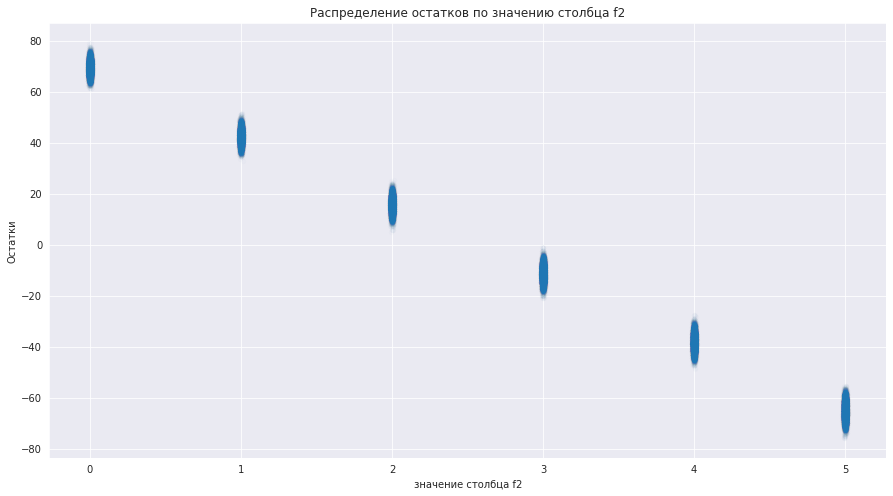

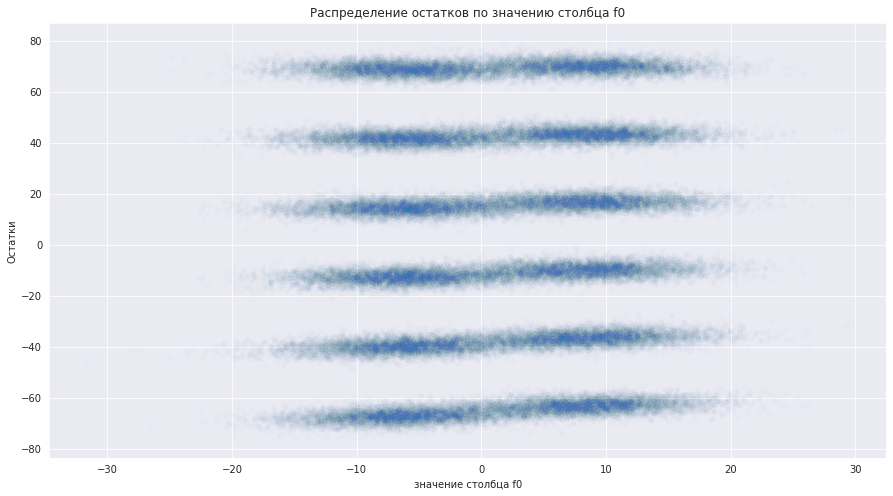

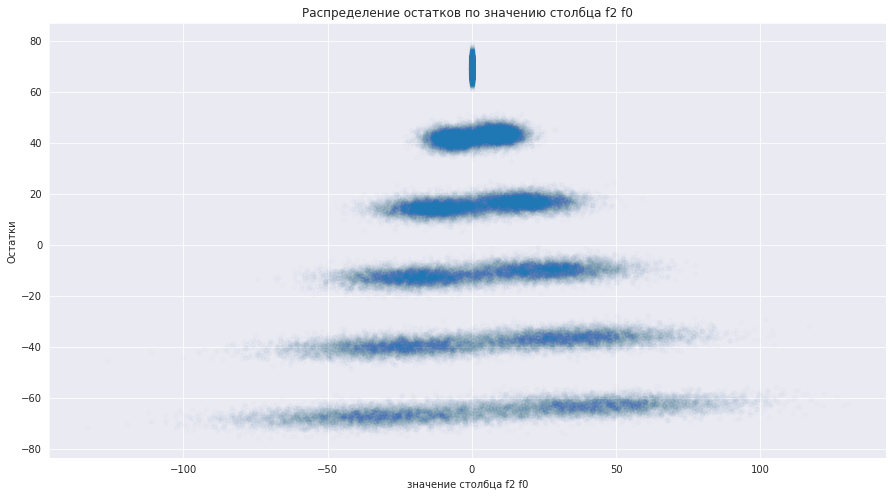

In [31]:
for feat in data_1_max_feat:
    resid_scatter(train_features_1, feat, 'residuals')

Для второго месторождения графики зависимости остатков имеют забавные распределения, как и ожидалось. Но так как это данные скорее для классификации, нежели для регрессии, вероятно, мы смогли бы увидеть другие графики, если бы мы при разделении соблюли баланс классов. Проверим, что будет, если мы обучимся на всей выборке, а не только на тестовой.

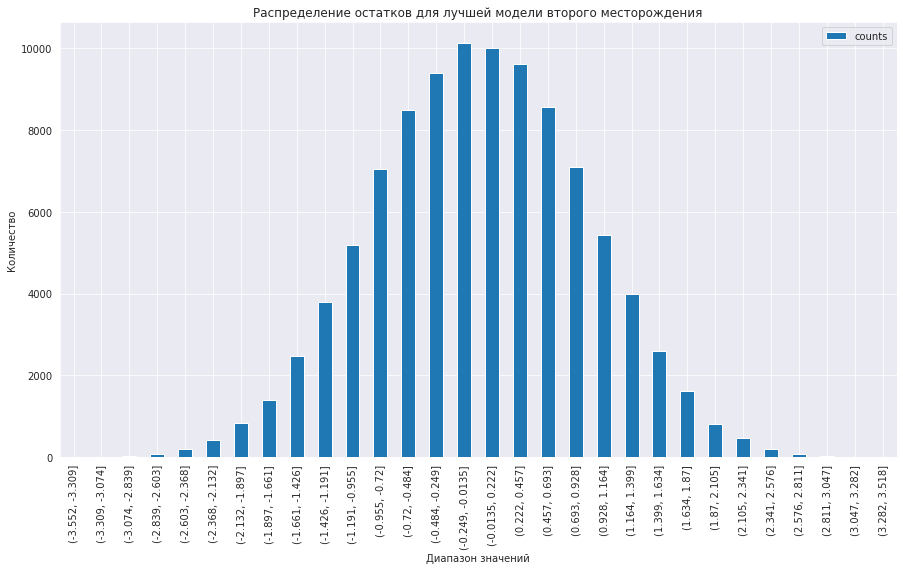

In [32]:
data_1_poly['residuals'] = LinearRegression().fit(data_1_poly[data_1_max_feat], data_1['product']).predict(data_1_poly[data_1_max_feat]) - data_1['product'].tolist()
pandas_bar_plot(30, 'residuals', data_1_poly, 'Распределение остатков для лучшей модели второго месторождения', 'Диапазон значений')

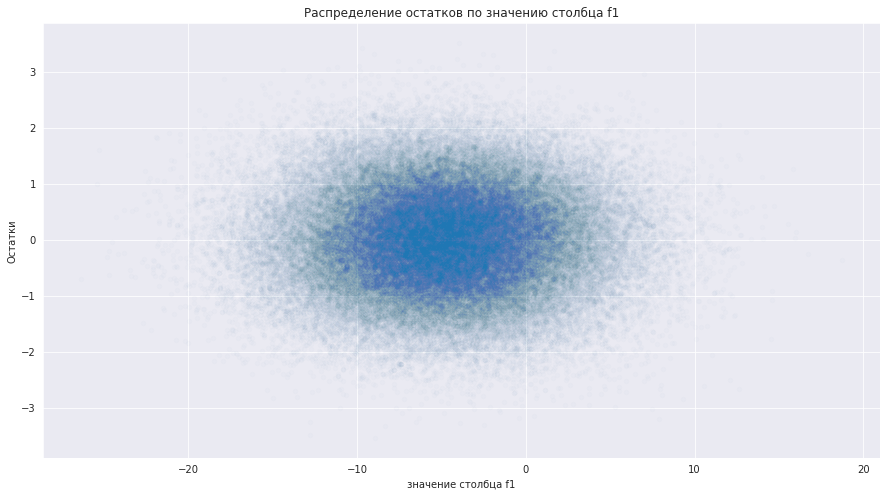

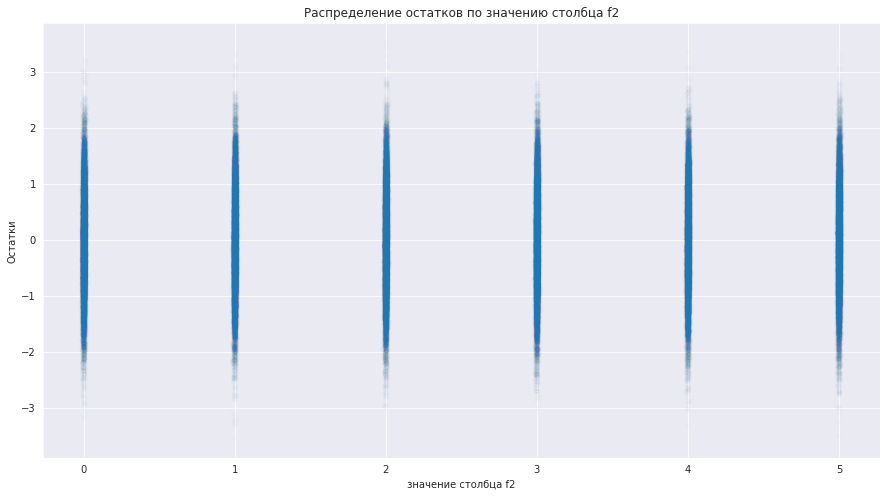

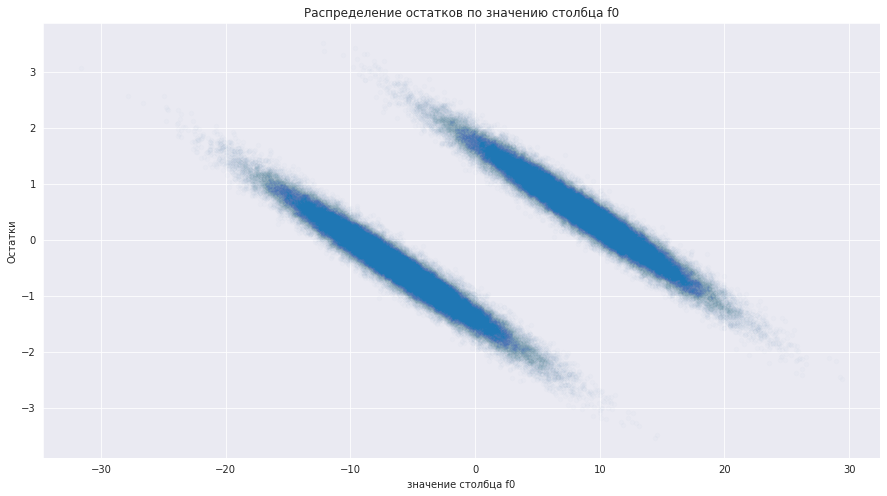

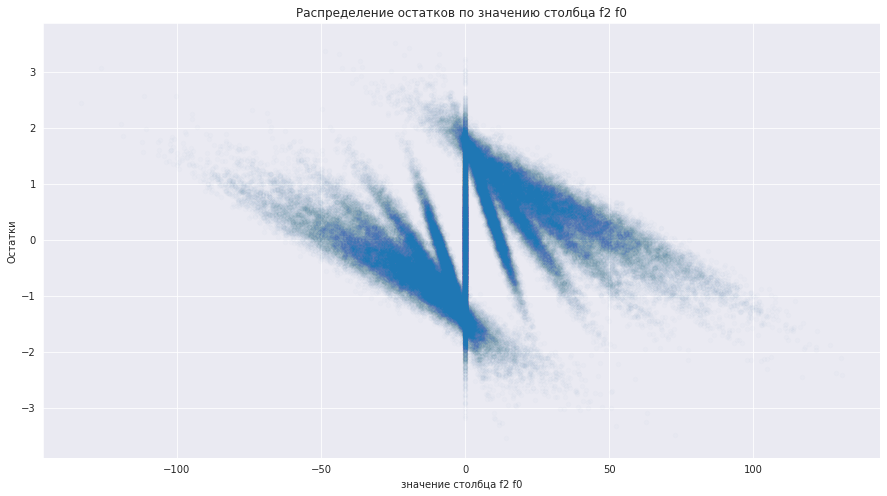

In [33]:
for feat in data_1_max_feat:
    resid_scatter(data_1_poly, feat, 'residuals')

Теперь гораздо лучше. Формально - столбцы __f0__ и __f2 f0__ не должны были быть включены в модель, о чем говорят и графики для этих столбцов, остальные графики формально правильны, так как распределение остатков не зависит от значения признака. Но надо отметить, что линейная регрессия со своей задачей справилась - остатки по модулю не превышают 3.

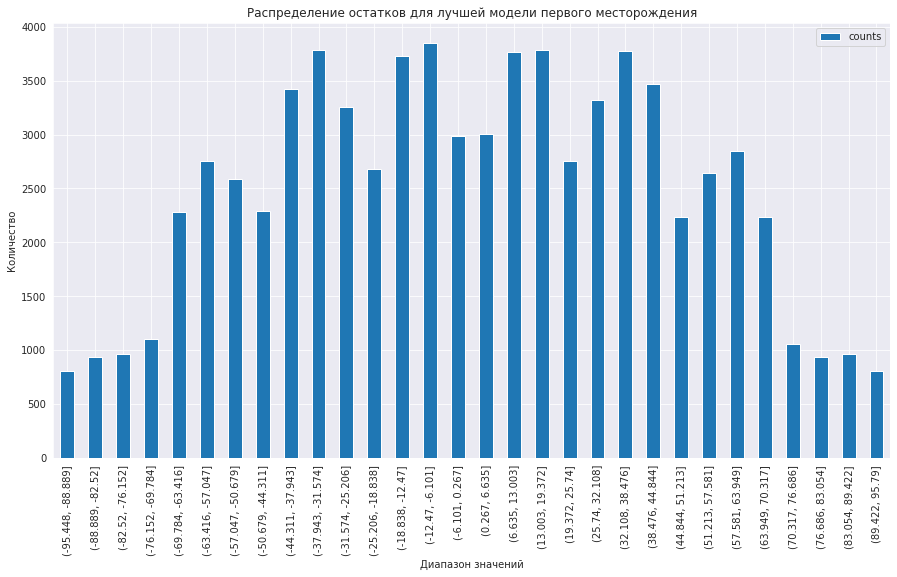

In [34]:
train_features_2['residuals'] = LinearRegression().fit(train_features_0[data_2_max_feat], train_target_2).predict(train_features_2[data_2_max_feat]) - train_target_2.tolist()
pandas_bar_plot(30, 'residuals', train_features_2, 'Распределение остатков для лучшей модели первого месторождения', 'Диапазон значений')

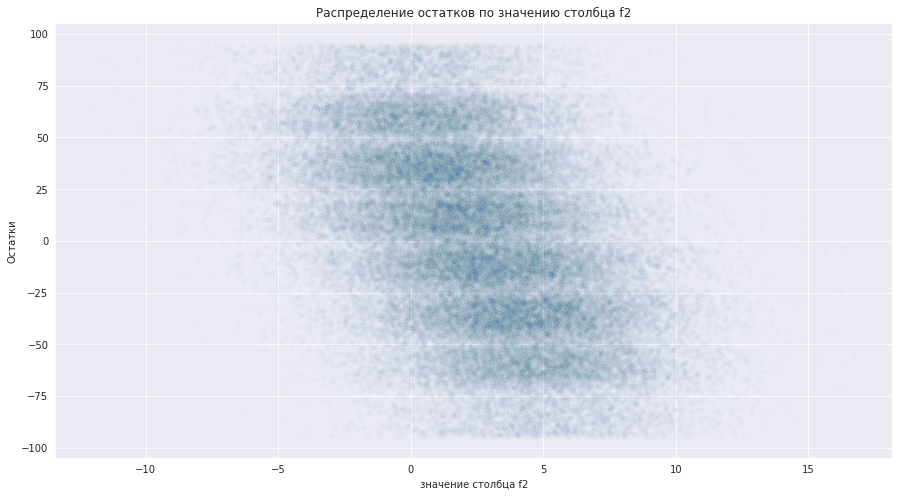

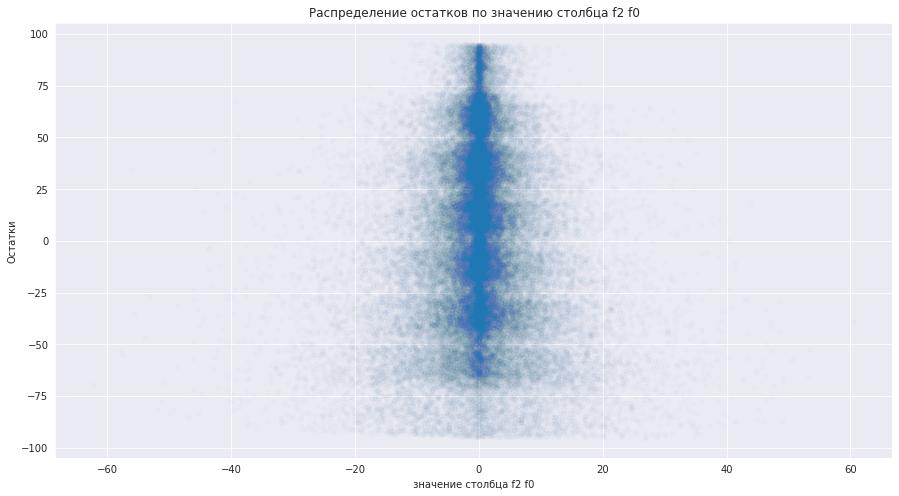

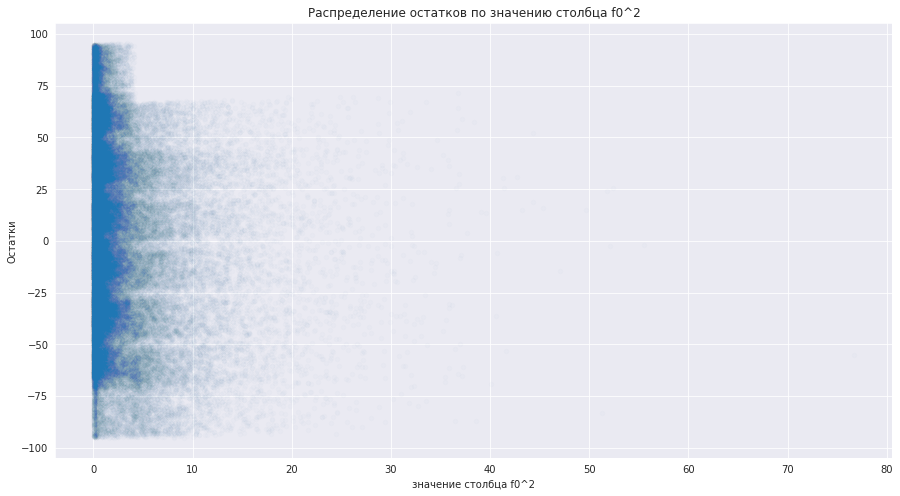

In [35]:
for feat in data_2_max_feat:
    resid_scatter(train_features_2, feat, 'residuals')

Для третьего региона остатки нормальны. Зависимость остатков от f2 выглядит не очень хорошо (при положительных f2 остатки чаще склонны быть отрицательными, нежели при отрицательных значениях), зависимость от f1^2 не очень ясна из-за сильно неравномерного распределения значений f1^2.

Теперь проверим полученные модели на валидационных выборках. Посмотрим на среднее количество предсказанного сырья и на RMSE.

In [36]:
predicted_val_0 = LinearRegression().fit(train_features_0[data_0_max_feat], train_target_0).predict(valid_features_0[data_0_max_feat])
print('Среднее значение предсказаний сырья для одной скважины в первом регионе:', sum(predicted_val_0)/len(predicted_val_0))
print('RMSE:', mean_squared_error(valid_target_0, predicted_val_0)**0.5)

Среднее значение предсказаний сырья для одной скважины в первом регионе: 92.59256778438005
RMSE: 37.5794217150813


In [37]:
predicted_val_1 = LinearRegression().fit(train_features_1[data_1_max_feat], train_target_1).predict(valid_features_1[data_1_max_feat])
print('Среднее значение предсказаний сырья для одной скважины во втором регионе:', sum(predicted_val_1)/len(predicted_val_1))
print('RMSE:', mean_squared_error(valid_target_1, predicted_val_1)**0.5)

Среднее значение предсказаний сырья для одной скважины во втором регионе: 68.72851952996987
RMSE: 0.8930543969551297


In [38]:
predicted_val_2 = LinearRegression().fit(train_features_2[data_2_max_feat], train_target_2).predict(valid_features_2[data_2_max_feat])
print('Среднее значение предсказаний сырья для одной скважины в первом регионе:', sum(predicted_val_2)/len(predicted_val_2))
print('RMSE:', mean_squared_error(valid_target_2, predicted_val_2)**0.5)

Среднее значение предсказаний сырья для одной скважины в первом регионе: 94.9647537491542
RMSE: 39.40591404548469


### Вывод

Для каждой тестовой выборки мы нашли признаки, которые соответствуют наилучшей модели линейной регрессии по метрике Adjusted R^2. Множество этих признаков соответствуют условиям применимости линейной регрессии: линейная зависимость, нормальность распределения остатков, гомоскедастичность остатков и отсутствие коллинеарности между признаками. Не все условия и тесты прошли хорошо, но в целом жить можно.

Для данных второго региона модель линейной регрессии не является хорошим вариантом - множественная классификация была бы более хорошим выбором для этих данных.

Имеем согласно моделям
* для первого региона в среднем 93 +- 38 тысяч баррелей нефти на скважину
* для второго региона в среднем 69 +- 1 тысяч баррелей нефти на скважину
* для третьего региона в среднем 95 +- 39 тысяч баррелей нефти на скважину

## Подготовка к расчёту прибыли

Определим параметры, данные нам по условию.

In [39]:
# чтобы не путаться, определим доход именно с 1000 баррелей, так как во всех таблицах у нас измерение именно в таких единицах
BARREL_1000_INCOME = 450000

# Общий бюджет на осваивание месторождений
BUDGET = 10000000000

# 
NUM_OF_BOOTSTRAP_ITERATIONS = 1000
BOOTSTRAP_SAMPLE_SIZE = 500

# количество осваиваемых месторождений
NUM_OF_BOREHOLES = 200

Рассчитаем достаточный объём сырья для безубыточной разработки новой скважины и сравним полученный объём сырья со средним запасом в каждом регионе

In [40]:
min_mean_product = BUDGET/(NUM_OF_BOREHOLES*BARREL_1000_INCOME)
print('Минимальное среднее значение столбца product для безубыточной разработки в регионе:', min_mean_product)

Минимальное среднее значение столбца product для безубыточной разработки в регионе: 111.11111111111111


Как видим, оно больше, чем все средние предсказанные значения в каждом из регионов. Но предсказания мы построили на 2500 месторождениях, а нам нужно выбрать 200 лучших - так что прибыли мы добиться можем.

Также напишем функцию для подсчета прибыли, которую будем в дальнейшем использовать для подсчета доверительного интервала для прибыли и подсчета возможных рисков.

In [41]:
def calculate_overall_income(predictions, values):
    indexes = np.argsort(predictions)[len(predictions) - NUM_OF_BOREHOLES:]
    return BARREL_1000_INCOME*sum([values[i] for i in indexes]) - BUDGET

### Вывод

Минимальное среднее значение объема нефти в скважине для безубыточной разработки - 111 тыс.баррелей. Как видим, оно больше, чем все средние предсказанные значения в каждом из регионов. Но предсказания мы построили на 2500 месторождениях, а нам нужно выбрать 200 лучших - так что мы можем добиться как прибыльной разработки, так и убыточной. Посчитать вероятности обоих вариантов нам помогут статистические методы.

## Расчёт прибыли и рисков 

Посчитаем риски и прибыль для каждого региона. Применим технику Bootstrap с 1000 выборок, чтобы найти распределение прибыли.

In [42]:
def bootstrap(data, val, reg_num='первого'):
    state = np.random.RandomState(123456)

    values = []
    for i in range(NUM_OF_BOOTSTRAP_ITERATIONS):
        subsample = pd.Series(data).sample(n=BOOTSTRAP_SAMPLE_SIZE, replace=False, random_state=state).sort_index()
        value = pd.Series(val).iloc[subsample.index].sort_index()
        values.append(calculate_overall_income(subsample.values, value.values))
    

    values_ser = pd.Series(values)

    lower = values_ser.quantile(0.025)
    upper = values_ser.quantile(0.975)

    print('Доверительный интервал прибыли для ' + reg_num + ' региона:', '[', lower, ',', upper, ']')
    print('Вероятность убытков:', (values_ser < 0).mean())
    print('Средняя прибыль:', values_ser.mean())

In [43]:
bootstrap(predicted_val_0, valid_target_0.tolist(), 'первого')

Доверительный интервал прибыли для первого региона: [ -108629657.46691537 , 898359164.3372765 ]
Вероятность убытков: 0.054
Средняя прибыль: 399284252.77590865


In [44]:
bootstrap(predicted_val_1, valid_target_1.tolist(), 'второго')

Доверительный интервал прибыли для второго региона: [ 20393120.417816114 , 859461094.6282253 ]
Вероятность убытков: 0.019
Средняя прибыль: 450862304.68949074


In [45]:
bootstrap(predicted_val_2, valid_target_2.tolist(), 'третьего')

Доверительный интервал прибыли для третьего региона: [ 1306958.0384858681 , 1041907904.0264276 ]
Вероятность убытков: 0.025
Средняя прибыль: 501112680.9158139


### Вывод

Самым выгодным вложением будет разработка месторождений в третьем регионе. Вероятность убытков 0.1%, доверительный интервал и средняя прибыль лучшие среди всех трех регионов.

## Вывод

Мы изучили данные. Определили наличие дубликатов (которое, правда, никак не использовали и не исправляли) в таблицах. После исследования дополнительно добавили несколько признаков, являющихся степенями исходных, для, возможно, большей точности построенных моделей. Были обнаружены нелепые зависимости в данных для второго региона. Были выбраны критерии и тесты для проверки адекватности построения линейной регрессии на нашем наборе признаков. Выборки были разделены на тестовые и валидационные для проверки качества моделей.

Для каждой тестовой выборки мы нашли признаки, которые соответствуют наилучшей модели линейной регрессии по метрике Adjusted R^2. Множество этих признаков соответствуют условиям применимости линейной регрессии: линейная зависимость, нормальность распределения остатков, гомоскедастичность остатков и отсутствие коллинеарности между признаками. Не все условия и тесты прошли хорошо, но в целом жить можно.

Для данных второго региона модель линейной регрессии не является хорошим вариантом - множественная классификация была бы более хорошим выбором для этих данных.

Имеем согласно моделям

* для первого региона в среднем 93 +- 38 тысяч баррелей нефти на скважину
* для второго региона в среднем 69 +- 1 тысяч баррелей нефти на скважину
* для третьего региона в среднем 95 +- 39 тысяч баррелей нефти на скважину

Был рассчитан достаточный объём сырья для безубыточной разработки новой скважины и сравнен со средним запасом в каждом регионе для предсказанных данных. Этот объем - 111 тыс.баррелей. Оно больше, чем все средние предсказанные значения в каждом из регионов (указаны выше). Но предсказания мы построили на 2500 месторождениях, а нам нужно выбрать 200 лучших - так что мы можем добиться как прибыльной разработки, так и убыточной. 

Для проверки вероятностей прибыли и убытков, а также рисков убытков мы применили технику Bootstrap с 1000 выборок. Были получены следующие результаты:

* для первого региона
    
    Доверительный интервал прибыли: [-108629657.5, 898359164.3]
    
    Вероятность убытков: 0.054
    
    Средняя прибыль: 399284252.8
    
    
* для второго региона

    Доверительный интервал прибыли: [20393120.4, 859461094.6]

    Вероятность убытков: 0.019
    
    Средняя прибыль: 450862304.7


* для третьего региона

    Доверительный интервал прибыли для третьего региона: [1306958.0, 1041907904.0]

    Вероятность убытков: 0.025
    
    Средняя прибыль: 501112680.9


Самым выгодным вложением оказалась разработка месторождений во втором регионе, так как он единственный, который удовлетворяет условию вероятности убытков меньше 2.5%. Но как было исследовано, данные там странные, поэтому я бы предложил проверить данные для этого региона, а также обратить внимание на третий регион (вероятность убытков там ровно 2.5%, но средняя прибыль выше, чем во всех остальных регионах).